
# population_local_example.py
## Notebook showing how to use japandata.population.local_pop_df
### Author: Sam Passaglia
#### （See the prefecture example first)


In [1]:
from japandata.population.data import local_pop_df as local_df
import os
import numpy as np

PLOT_FOLDER = os.path.join(os.getcwd(),'population_local_example/')
output_filetypes = ['pdf']
os.makedirs(PLOT_FOLDER, exist_ok=True)

# Very importantly, the local population dataframe contains duplicates: rows for both designated cities and subcomponents. These duplicates can be filtered out using the map for the corresponding year.

In [2]:
from japandata.maps.data import load_map
from japandata.population.data import prefecture_pop_df

In [36]:
restricted_df = local_df.copy()
for year in np.unique(restricted_df['year']):
    map_df = load_map(year, level='local_dc')
    subdf = restricted_df.loc[restricted_df['year']==year]
    rowstodrop  = subdf.loc[~subdf['code'].isin(map_df['code'].values)]
    restricted_df.drop(rowstodrop.index, inplace=True)
    ### check that we did a good job
    #print('The local pop df overcounts by', np.mean(local_df.loc[local_df['year']==year].groupby('prefecture').sum()['total-pop'].values/prefecture_pop_df.loc[prefecture_pop_df['year']==year]['total-pop'].values)-1)
    #print('Once restricted using map, it overcounts by', np.mean(restricted_df.loc[restricted_df['year']==year].groupby('prefecture').sum()['total-pop'].values/prefecture_pop_df.loc[prefecture_pop_df['year']==year]['total-pop'].values)-1)

In [37]:
local_df = restricted_df
local_arr = local_df.set_index(['code', 'year']).to_xarray()

# Matplotlib and Plotly Figures

In [38]:
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
try:
    ## Load my helper plotting module if it is available
    from samplot.utils import init_plotting
except ImportError():
    def init_plotting(**_): return plt.subplots()

# Population vs Growth ###

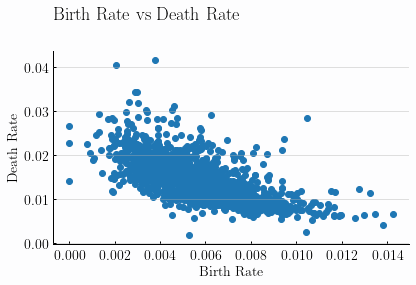

In [39]:
fig, ax = init_plotting(style='nyt')
title_string = r"Birth Rate vs Death Rate "
fig.suptitle(title_string, x=0,y=1.15, fontsize=18,ha='left',va='bottom', transform=ax.transAxes)
year = [2020]
ax.scatter(local_arr.loc[{'year':year}]['born']/local_arr.loc[{'year':year}]['total-pop'],local_arr.loc[{'year':year}]['died']/local_arr.loc[{'year':year}]['total-pop'])
ax.set_xlabel("Birth Rate")
ax.set_ylabel("Death Rate")
for suffix in output_filetypes:
    fig.savefig(PLOT_FOLDER+'birth_vs_death.'+suffix, transparent=True)

In [40]:
temp_df = local_df[['born','died','prefecture','year', 'code','city']]
temp_df = temp_df.assign(birth_rate = temp_df['born'].divide(local_df['total-pop']))
temp_df = temp_df.assign(death_rate = temp_df['died'].divide(local_df['total-pop']))
fig = px.scatter(temp_df.loc[temp_df['year'].isin(year)], x='birth_rate',y='death_rate', color='prefecture', hover_data=['code','prefecture', 'city'])
fig.write_html(PLOT_FOLDER+'birth_vs_death.html')
fig

### The rate columns are defined relative to the previous year.

In [41]:
for year in np.unique(local_arr['year'])[1:]:
    print(local_arr.loc[{'year':year}]['born-minus-died-rate'] / (local_arr.loc[{'year':year}]['born-minus-died']/ local_arr.loc[{'year':year-1}]['total-pop']*100))

<xarray.DataArray (code: 3584)>
array([1., 1., 1., ..., 1., 1., 1.])
Coordinates:
  * code     (code) object '01100' '01202' '01203' ... '47375' '47381' '47382'
    year     int64 1995
<xarray.DataArray (code: 3584)>
array([1., 1., 1., ..., 1., 1., 1.])
Coordinates:
  * code     (code) object '01100' '01202' '01203' ... '47375' '47381' '47382'
    year     int64 1996
<xarray.DataArray (code: 3584)>
array([1., 1., 1., ..., 1., 1., 1.])
Coordinates:
  * code     (code) object '01100' '01202' '01203' ... '47375' '47381' '47382'
    year     int64 1997
<xarray.DataArray (code: 3584)>
array([1., 1., 1., ..., 1., 1., 1.])
Coordinates:
  * code     (code) object '01100' '01202' '01203' ... '47375' '47381' '47382'
    year     int64 1998
<xarray.DataArray (code: 3584)>
array([1., 1., 1., ..., 1., 1., 1.])
Coordinates:
  * code     (code) object '01100' '01202' '01203' ... '47375' '47381' '47382'
    year     int64 1999
<xarray.DataArray (code: 3584)>
array([1., 1., 1., ..., 1., 1., 1.])
Coordi

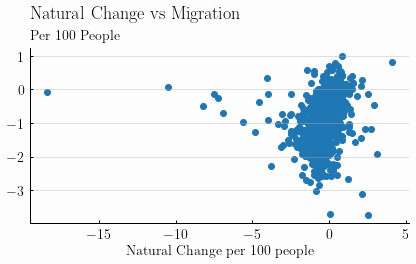

In [42]:
fig, ax = init_plotting(style='nyt')
title_string = r"Natural Change vs  Migration"
subtitle_string = r"Per 100 People"
ax.set_title(subtitle_string, x=0., y=1.0, fontsize=14,ha='left',va='bottom')
fig.suptitle(title_string, x=0,y=1.15, fontsize=18,ha='left',va='bottom', transform=ax.transAxes)
year = [2020]
ax.scatter(local_arr.loc[{'year':year}]['social-in-minus-social-out-rate'],local_arr.loc[{'year':year}]['born-minus-died-rate'])
ax.set_xlabel('Migration per 100 people')
ax.set_xlabel('Natural Change per 100 people')
for suffix in output_filetypes:
    fig.savefig(PLOT_FOLDER+'natural-vs-social.'+suffix, transparent=True)

In [43]:
temp_df = local_df.copy()
fig = px.scatter(temp_df.loc[temp_df['year'].isin(year)], y='born-minus-died-rate',x='social-in-minus-social-out-rate', color='total-pop', hover_data=['code','prefecture', 'city'])
fig.write_html(PLOT_FOLDER+'natural-vs-social.html')
fig

# Folium Interactive Maps

In [44]:
import folium
from folium.features import GeoJsonTooltip
from branca.colormap import linear
from japandata.maps.data import load_map

unhighlighted_style = {
"color": "black",
"weight": 1,
"fillOpacity": 1,
}

highlighted_style = unhighlighted_style | {'weight':4}

map_style = {'location':[35.67, 139], 'zoom_start':5, 'tiles':'None','attr':" "}

mapyear = 2020
map_df = load_map(mapyear,'local_dc')
df = local_df.loc[local_df['year']==mapyear]

## Folium: Prefecture Map Natural Decline Rate

In [45]:
df['natural-decline-rate'] = -df['born-minus-died-rate']

datacolumn= "natural-decline-rate"
datacolumnalias = "Annual Natural Population Decline Per 100 People"
scalingfactor = 1

map_df[datacolumn] = 0
for i in range(len(map_df)):
    try: 
        map_df.loc[i, datacolumn] =  (df.loc[df['code'] == map_df.loc[i,'code'],datacolumn].values[0]/scalingfactor)
    except IndexError: 
        print(map_df.loc[i,'code'])

largestdeviation = np.max(np.abs(map_df[datacolumn]))

colormap = linear.OrRd_09.scale(
    vmin=0, vmax=largestdeviation
)

m = folium.Map(**map_style)

tooltip = GeoJsonTooltip(
    fields=["prefecture", "city", datacolumn],
    aliases=["Prefecture:", "City:", datacolumnalias + ':'],
    localize=True,
    sticky=False,
    labels=True,
    style="""
        background-color: #F0EFEF;
        border: 2px solid black;
        border-radius: 3px;
        box-shadow: 3px;
    """,
    max_width=800,
)

def fillColor(feature):
    try: 
        return colormap(feature["properties"][datacolumn]) 
    except ValueError: 
        return 'black'
    except KeyError:
        return 'black'

folium.GeoJson(map_df
,name = datacolumn
,style_function=lambda feature: 
{'fillColor':fillColor(feature)} | unhighlighted_style
,highlight_function=lambda feature: 
{'fillColor':fillColor(feature)} | highlighted_style
,zoom_on_click=True
,tooltip=tooltip
).add_to(m)

colormap.caption = datacolumnalias
colormap.add_to(m)

m.save(PLOT_FOLDER+"naturaldeclinerate.html")
m

None
None
None
None


## Folium: Prefecture Map Migration Rate ##########

In [46]:
datacolumn= "social-in-minus-social-out-rate"
datacolumnalias = "Migration per 100 People"
scalingfactor = 1

map_df[datacolumn] = 0
for i in range(len(map_df)):
    try: 
        map_df.loc[i, datacolumn] =  (df.loc[df['code'] == map_df.loc[i,'code'],datacolumn].values[0]/scalingfactor)
    except IndexError: 
        print(map_df.loc[i,'code'])

largestdeviation = np.max(np.abs(map_df[datacolumn]))
largestdeviation = 2
colormap = linear.RdBu_11.scale(
    vmin=-largestdeviation, vmax=largestdeviation
)

m = folium.Map(**map_style)

tooltip = GeoJsonTooltip(
    fields=["prefecture", "city", datacolumn],
    aliases=["Prefecture:", "City:", datacolumnalias + ':'],
    localize=True,
    sticky=False,
    labels=True,
    style="""
        background-color: #F0EFEF;
        border: 2px solid black;
        border-radius: 3px;
        box-shadow: 3px;
    """,
    max_width=800,
)

def fillColor(feature):
    try: 
        return colormap(feature["properties"][datacolumn]) 
    except ValueError: 
        print(feature["properties"]["name"])
        return 'black'
    except KeyError:
        print(feature["properties"]["name"])
        return 'black'

folium.GeoJson(map_df
,name = datacolumn
,style_function=lambda feature: 
{'fillColor':fillColor(feature)} | unhighlighted_style
,highlight_function=lambda feature: 
{'fillColor':fillColor(feature)} | highlighted_style
,zoom_on_click=True
,tooltip=tooltip
).add_to(m)

colormap.caption = datacolumnalias
colormap.add_to(m)

m.save(PLOT_FOLDER+"migration.html")
m

None
None
None
None
